<a href="https://colab.research.google.com/github/Tdas-christ/CV/blob/main/2348569_Denoising_of_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# **Step 1: Read the original image**

In [4]:
img = cv2.imread('/content/drive/MyDrive/IMAGES (CV)/panda.jpg')

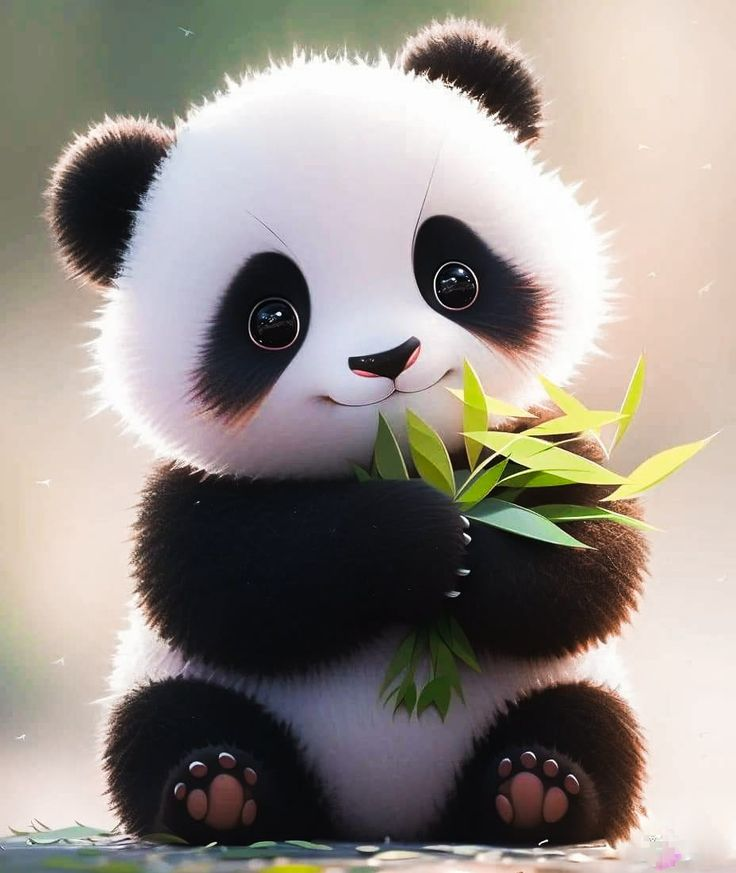

In [5]:
cv2_imshow(img)

# **Step 2: Add noise to the image**


Salt-and-Pepper Noisy Image


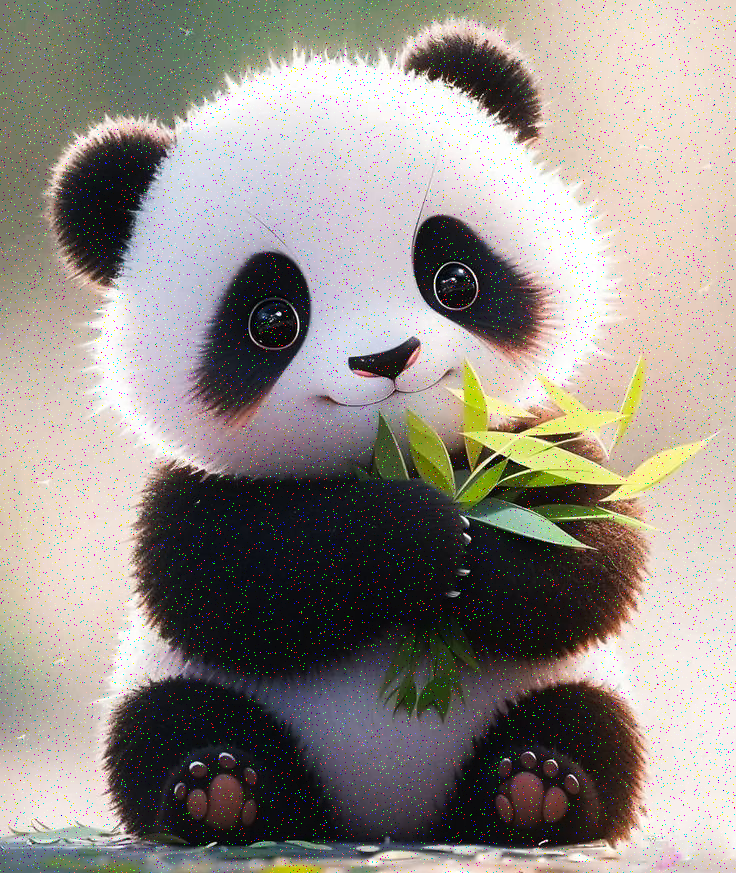

In [7]:
def add_salt_and_pepper_noise(image, salt_prob, pepper_prob):
    noisy_image = np.copy(image)
    salt_mask = np.random.rand(*image.shape) < salt_prob
    pepper_mask = np.random.rand(*image.shape) < pepper_prob
    noisy_image[salt_mask] = 255
    noisy_image[pepper_mask] = 0
    return noisy_image

noisy_img1 = add_salt_and_pepper_noise(img, salt_prob=0.01, pepper_prob=0.01)
print('Salt-and-Pepper Noisy Image')
cv2_imshow(noisy_img1)
cv2.waitKey(0)
cv2.destroyAllWindows()

Gaussian Noisy Image


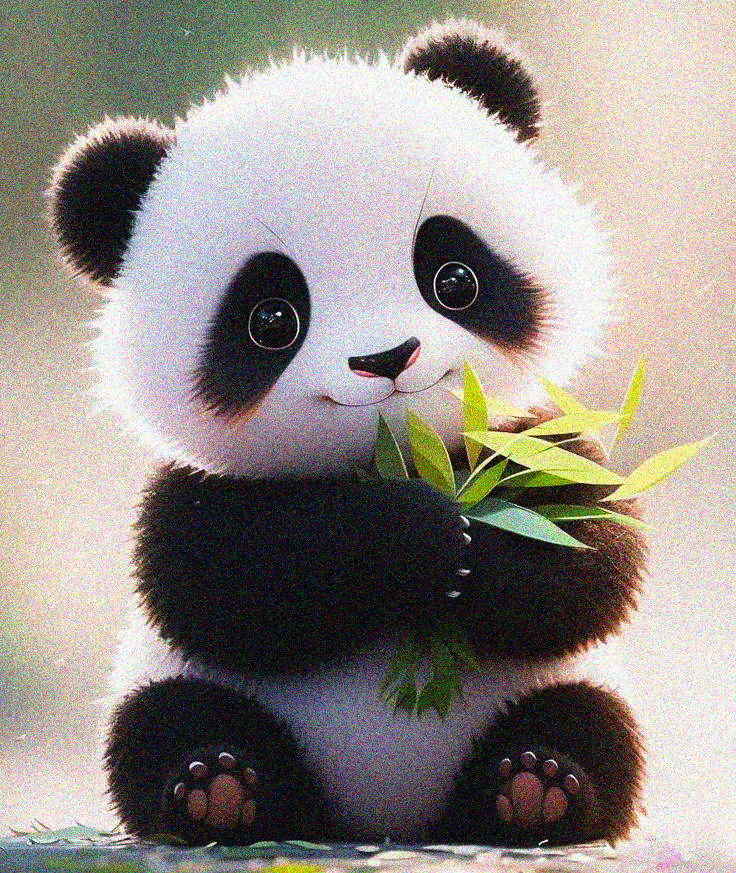

In [9]:
def add_gaussian_noise(image, mean=0, std_dev=25):
    noisy_image = np.copy(image)
    noise = np.random.normal(mean, std_dev, image.shape)
    noisy_image = noisy_image.astype(np.float32) + noise
    np.clip(noisy_image, 0, 255, out=noisy_image)
    noisy_image = noisy_image.astype(np.uint8)
    return noisy_image

noisy_img2 = add_gaussian_noise(img)
print('Gaussian Noisy Image')
cv2_imshow(noisy_img2)
cv2.waitKey(0)
cv2.destroyAllWindows()

Uniform Noisy Image


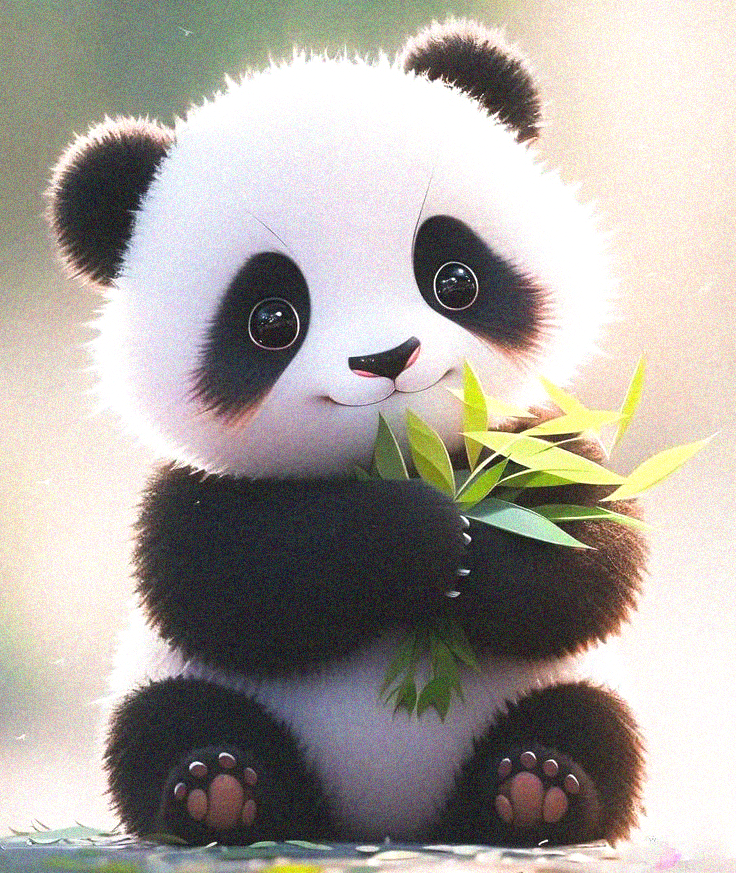

In [11]:
def add_uniform_noise(image, min_val=0, max_val=50):
    noisy_image = np.copy(image)
    noise = np.random.uniform(min_val, max_val, image.shape)
    noisy_image = noisy_image.astype(np.float32) + noise
    np.clip(noisy_image, 0, 255, out=noisy_image)
    noisy_image = noisy_image.astype(np.uint8)
    return noisy_image


noisy_img3 = add_uniform_noise(img)
print('Uniform Noisy Image')
cv2_imshow(noisy_img3)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
# adding random values of noises using numpy
noise = np.random.normal(loc=0, scale=50, size=img.shape)
noisy_img = np.clip(img + noise, 0, 255).astype(np.uint8)

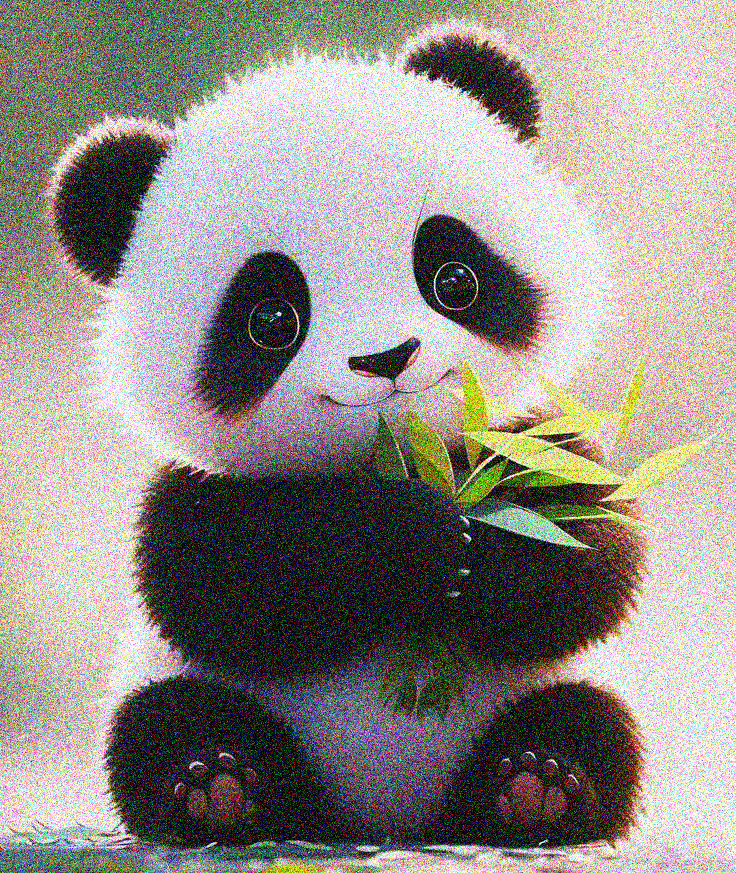

In [ ]:
cv2_imshow(noisy_img)

# **Step 3: Apply filtering techniques to restore the image and display the images**


# Gaussian Blur

In [17]:
rimage1 = cv2.GaussianBlur(noisy_img1, (5, 5), 0)

Salt and Pepper Noise Removal using Gaussian Blur


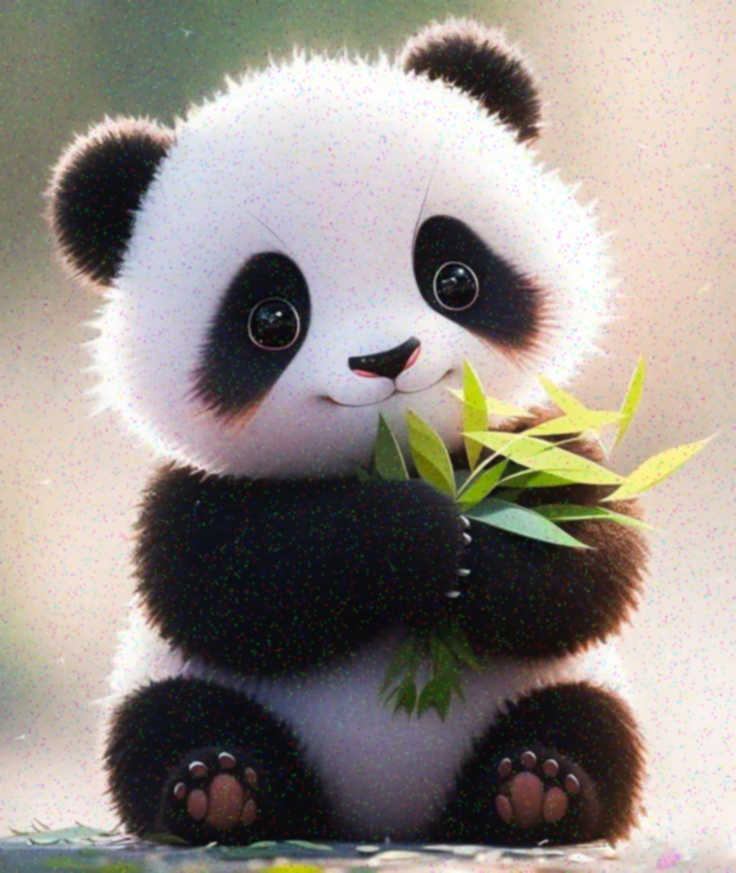

In [18]:
print('Salt and Pepper Noise Removal using Gaussian Blur')
cv2_imshow(rimage1)

Gaussian Noise Removal using Gaussian Blur


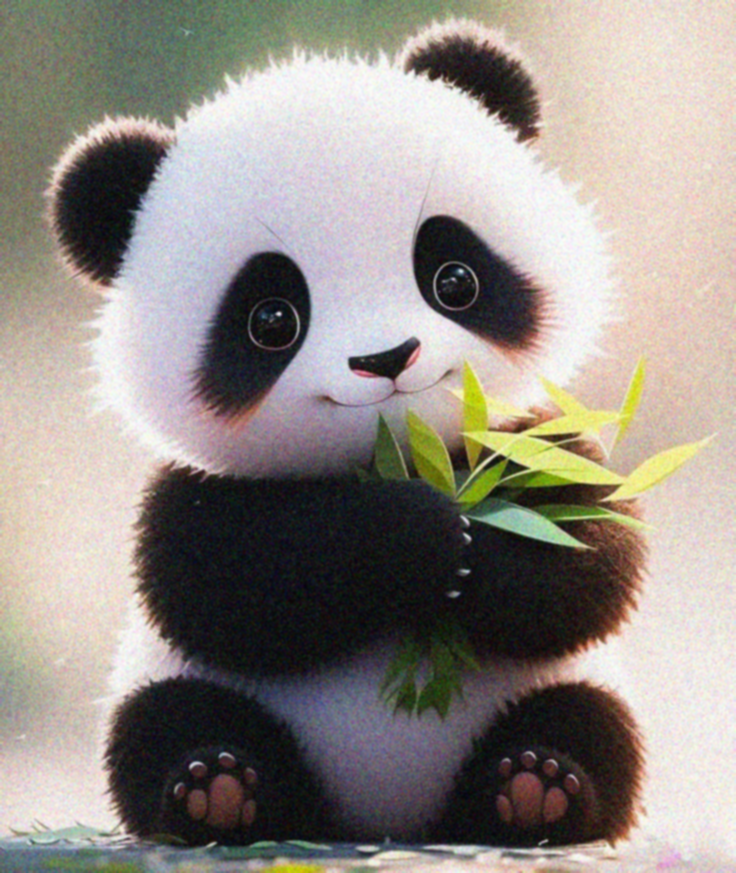

In [19]:
rimage2 = cv2.GaussianBlur(noisy_img2, (5, 5), 0)
print('Gaussian Noise Removal using Gaussian Blur')
cv2_imshow(rimage2)

Uniform Noise Removal using Gaussian Blur


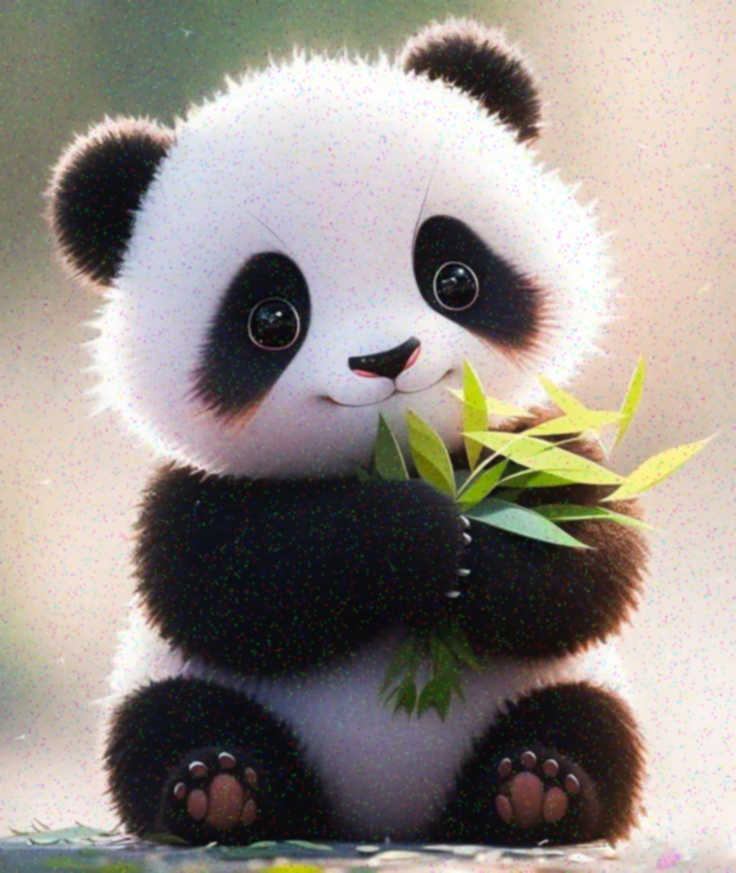

In [20]:
rimage3 = cv2.GaussianBlur(noisy_img1, (5, 5), 0)
print('Uniform Noise Removal using Gaussian Blur')
cv2_imshow(rimage3)

# Median Blur

Salt and Pepper Noise Removal using Median Blur


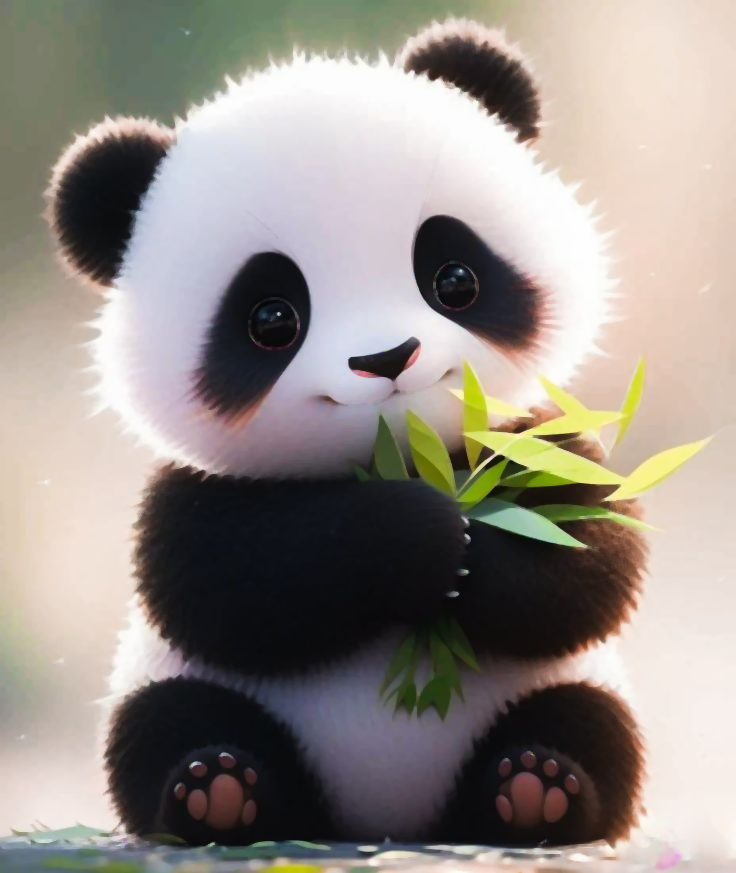

In [21]:
rmimg1 = cv2.medianBlur(noisy_img1, 5)
print('Salt and Pepper Noise Removal using Median Blur')
cv2_imshow(rmimg1)

Gaussian Noise Removal using Median Blur


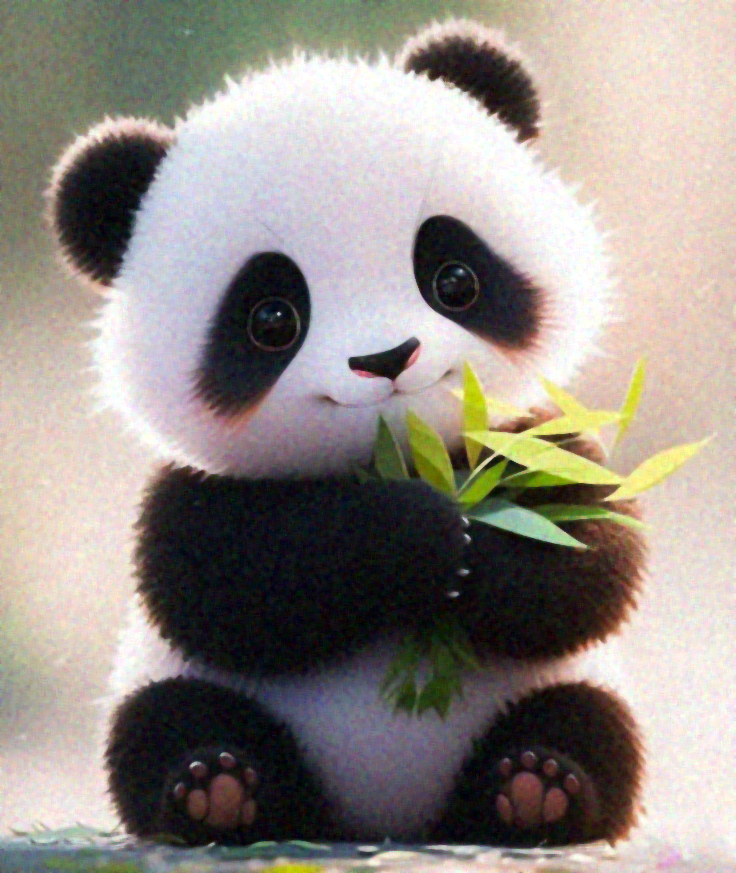

In [22]:
rmimg2 = cv2.medianBlur(noisy_img2, 5)
print('Gaussian Noise Removal using Median Blur')
cv2_imshow(rmimg2)

Uniform Noise Removal using Median Blur


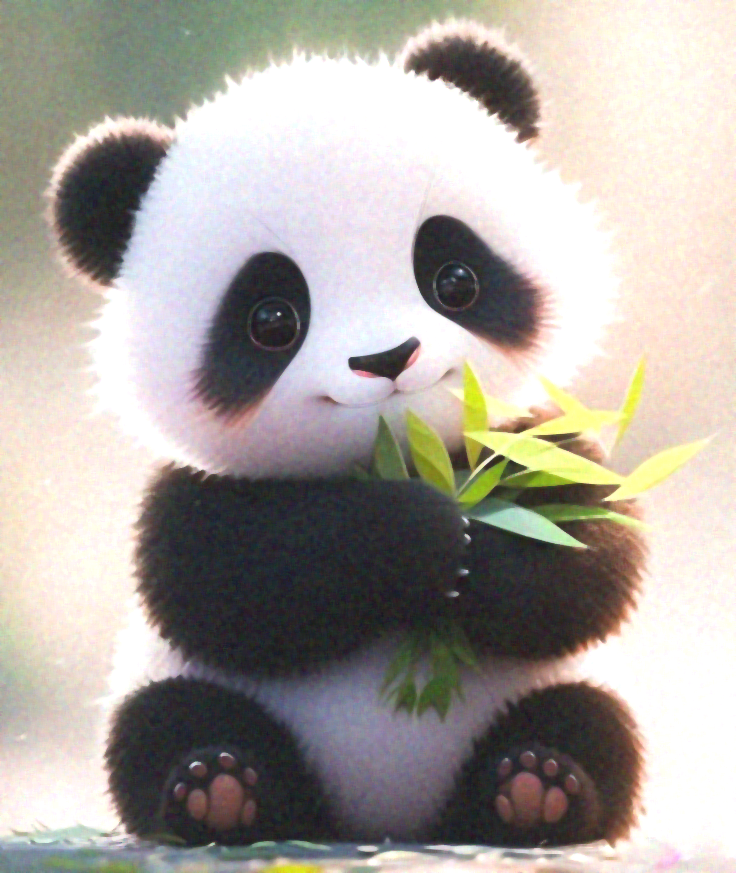

In [23]:
rmimg3 = cv2.medianBlur(noisy_img3, 5)
print('Uniform Noise Removal using Median Blur')
cv2_imshow(rmimg3)

# Min Filter

Salt and Pepper Noise Removal using Min Filter


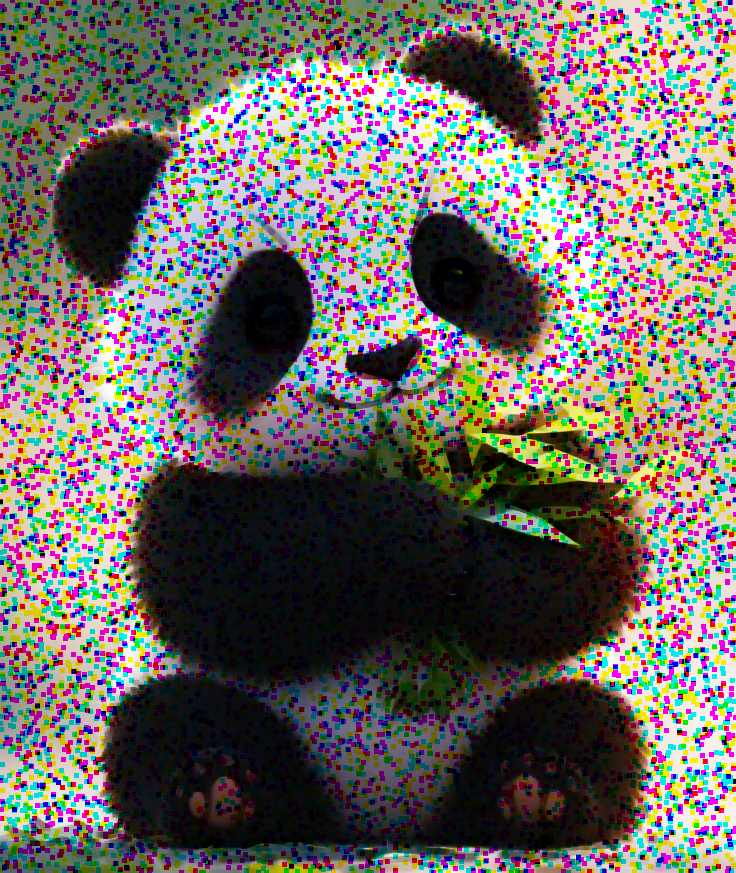

In [31]:
k_size=5
minimg1 = cv2.erode(noisy_img1, np.ones((k_size, k_size), np.uint8))
print('Salt and Pepper Noise Removal using Min Filter')
cv2_imshow(minimg1)

Gaussian Noise Removal using Min Filter


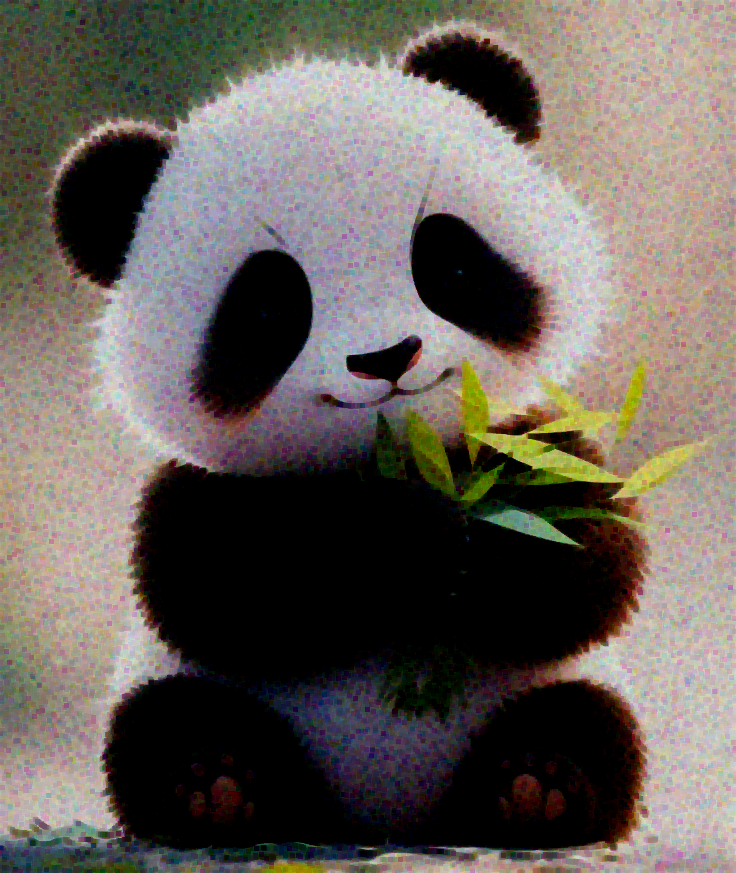

In [32]:
minimg2 = cv2.erode(noisy_img2, np.ones((k_size, k_size), np.uint8))
print('Gaussian Noise Removal using Min Filter')
cv2_imshow(minimg2)

Uniform Noise Removal using Min Filter


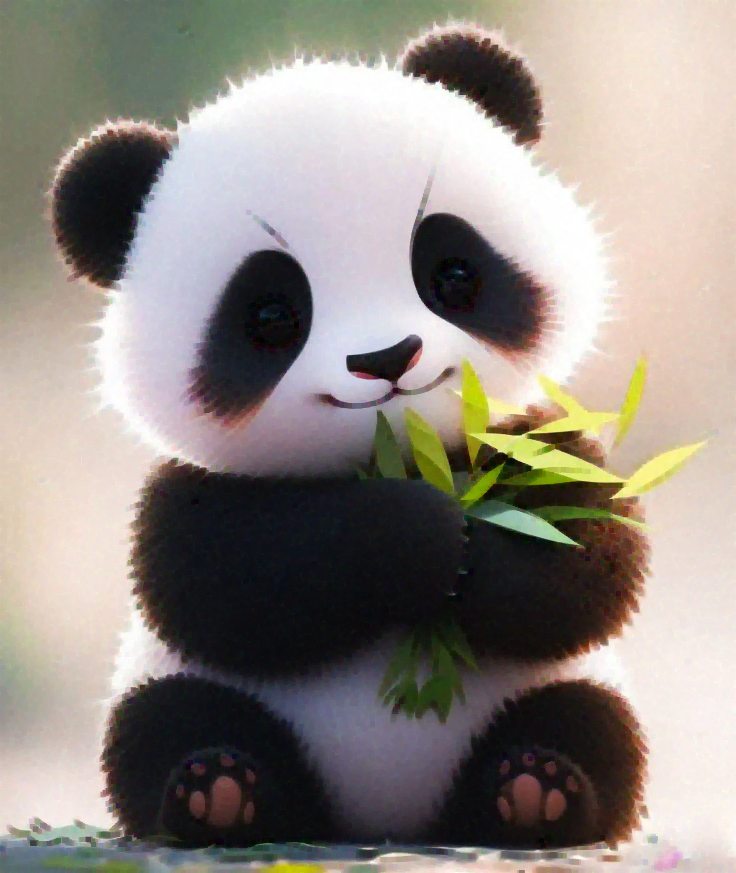

In [33]:
minimg3 = cv2.erode(noisy_img3, np.ones((k_size, k_size), np.uint8))
print('Uniform Noise Removal using Min Filter')
cv2_imshow(minimg3)

# Maximum Filter

Salt and Pepper Noise Removal using Max Filter


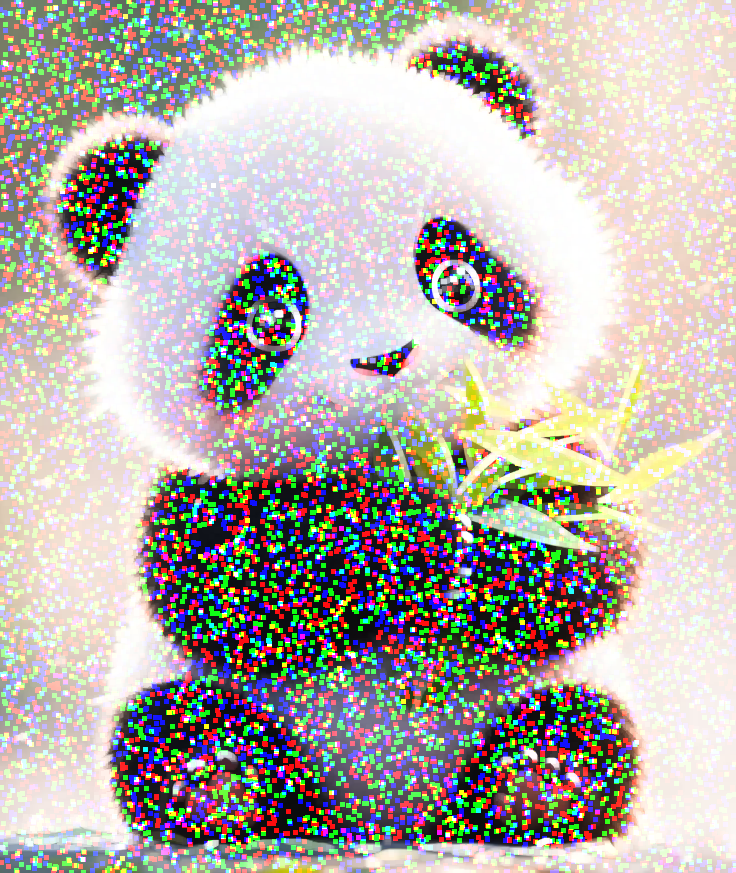

In [34]:
maximg1 = cv2.dilate(noisy_img1, np.ones((k_size, k_size), np.uint8))
print('Salt and Pepper Noise Removal using Max Filter')
cv2_imshow(maximg1)

Gaussian Noise Removal using Max Filter


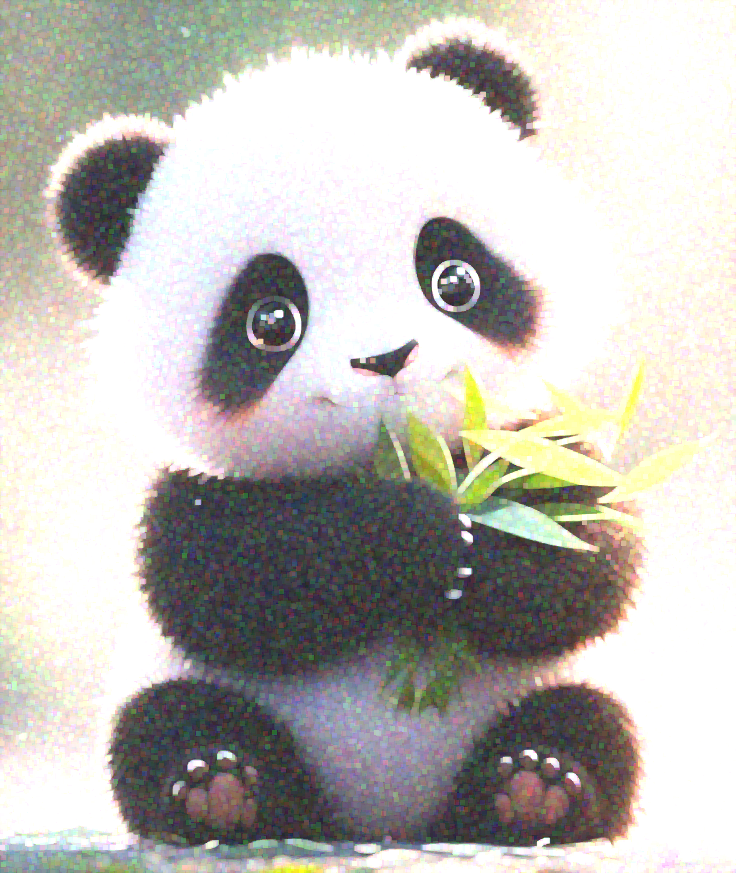

In [35]:
maximg2 = cv2.dilate(noisy_img2, np.ones((k_size, k_size), np.uint8))
print('Gaussian Noise Removal using Max Filter')
cv2_imshow(maximg2)

Uniform Noise Removal using Max Filter


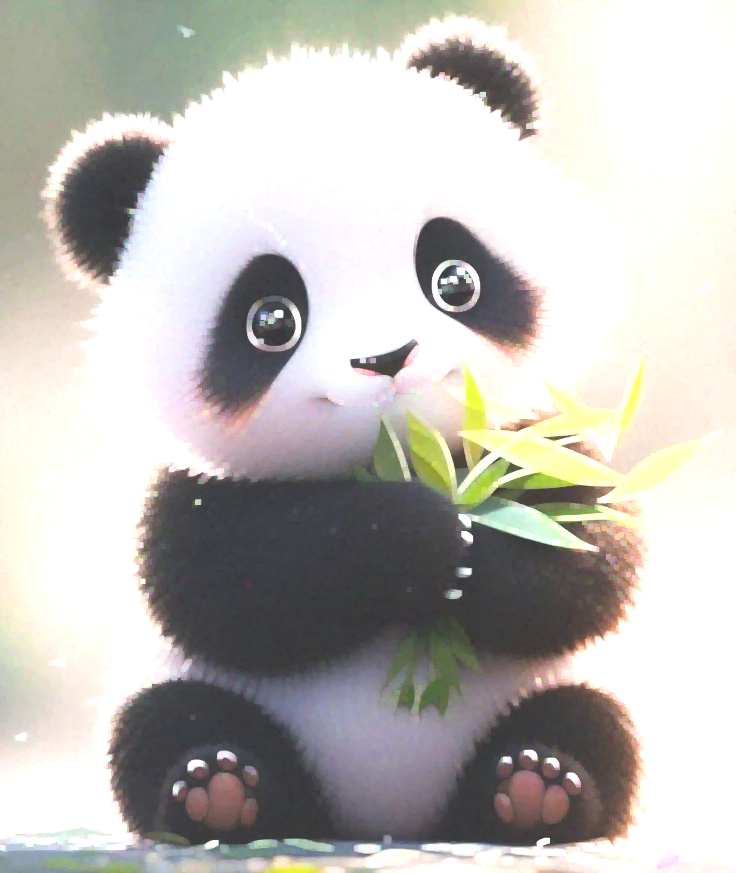

In [36]:
maximg3 = cv2.dilate(noisy_img3, np.ones((k_size, k_size), np.uint8))
print('Uniform Noise Removal using Max Filter')
cv2_imshow(maximg3)

# Midpoint Filter

Salt and Pepper Noise Removal using Midpoint Filter


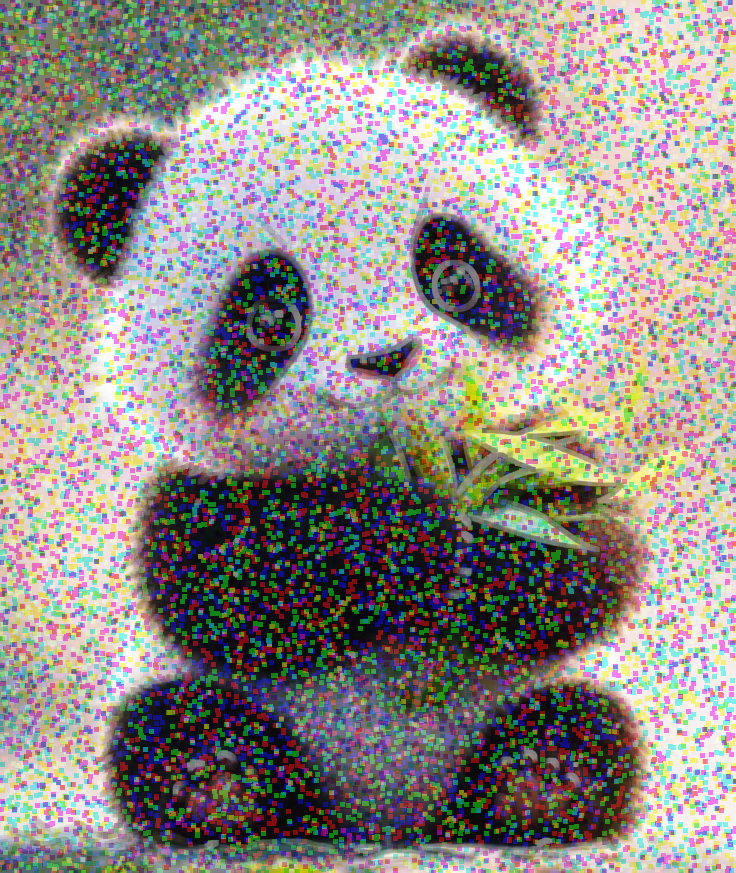

In [38]:
midimg1= cv2.addWeighted(minimg1, 0.5, maximg1, 0.5, 0)
print('Salt and Pepper Noise Removal using Midpoint Filter')
cv2_imshow(midimg1)

Gaussian Noise Removal using Midpoint Filter


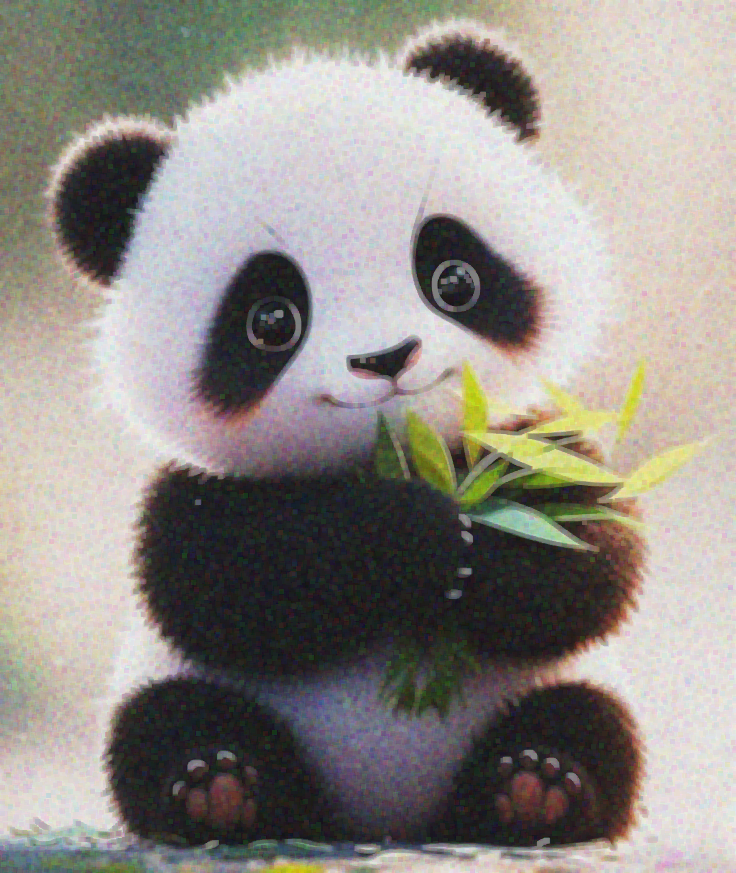

In [39]:
midimg2= cv2.addWeighted(minimg2, 0.5, maximg2, 0.5, 0)
print('Gaussian Noise Removal using Midpoint Filter')
cv2_imshow(midimg2)

Uniform Noise Removal using Midpoint Filter


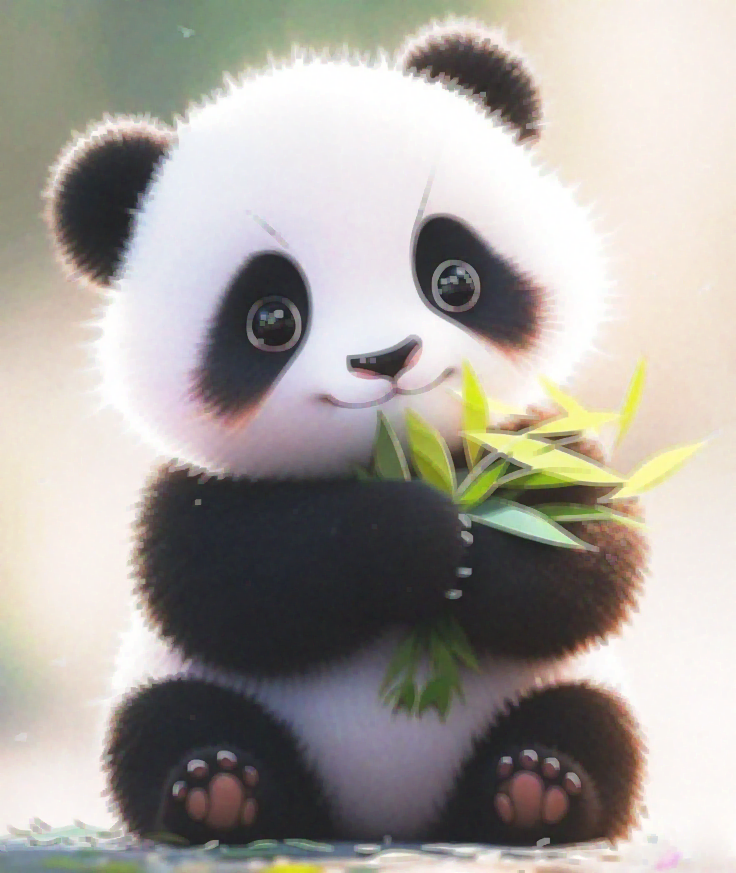

In [41]:
midimg3= cv2.addWeighted(minimg3, 0.5, maximg3, 0.5, 0)
print('Uniform Noise Removal using Midpoint Filter')
cv2_imshow(midimg3)

In [42]:
restored_image_bilateral = cv2.bilateralFilter(noisy_img, 9, 75, 75)

Random Noise Removal using Bilateral Filter


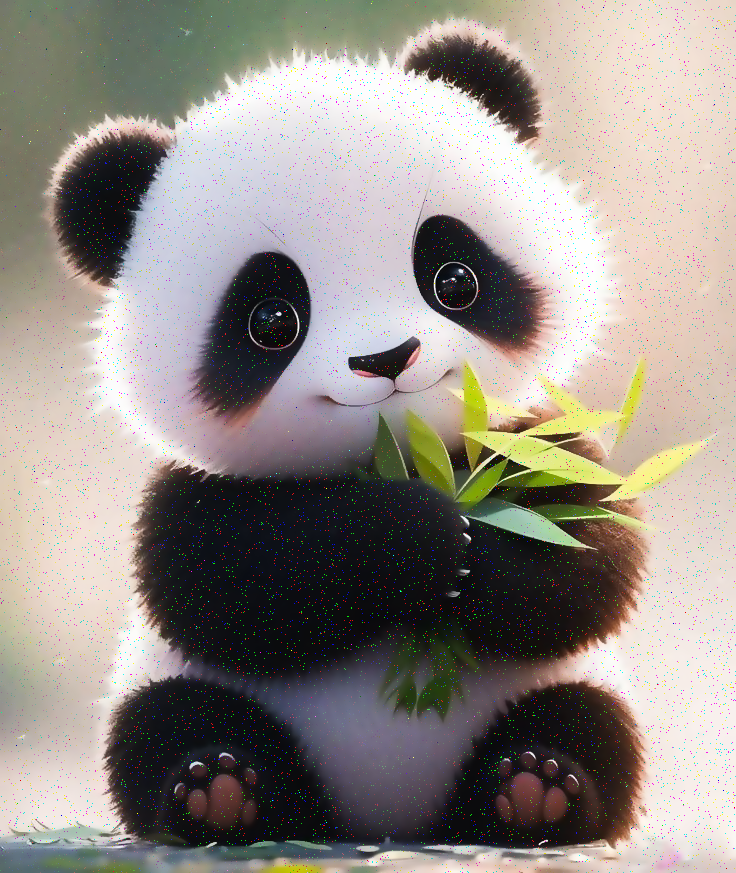

In [43]:
print('Random Noise Removal using Bilateral Filter')
cv2_imshow(restored_image_bilateral)